<p style="font-family: Arial; font-size:1.85em;color:purple; font-style:bold"><br>
Up & Running of Image Data <br><br>Analysis Using Numpy & OpenCV - Part 1</p>

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Introduction : A Little Bit About Pixel</p>

Computer store images as a mosaic of tiny squrares. This is like the ancient art form of tile mosaic, or the melting bead kits kids play with today. Now, if these square tiles are too big, it's then hard to make smooth edges and curves. The more and smaller tiles we use, the smoother or as we say less pixelated, image will be. These sometimes gets referred to as resoulution of the images.

Vector graphics are somewhat different method of storing images that aims to avoid pixel related issues. But even vecotr images, in the end, are displayed as a mosaic of pixels. The word `pixel` means a **picture element**. A simple way to describe each pixel is using a combination of three colors, namely **`Red, Green, Blue`**. This is what we call an `RGB` image. 

In an RGB image, each pixel is represented by three **8 bit** numbers associated to the values for **`Red, Green, Blue`** respectively. Eventually using a magnifying glass, if we zoom a picture, we'll see the pictue is made up of tiny dots of little light or more specifically the pixels and what more interesting is to see that tose tiny dots of little light are actually multiple tiny dots of little light of different colors which are nothing but **`Red Green Blue`** channels. 

Pixel together from far away, create an image and upfront they're just little lights that are **ON** and **OFF**. The combination of those create images and basically what we see on screen every single day. 


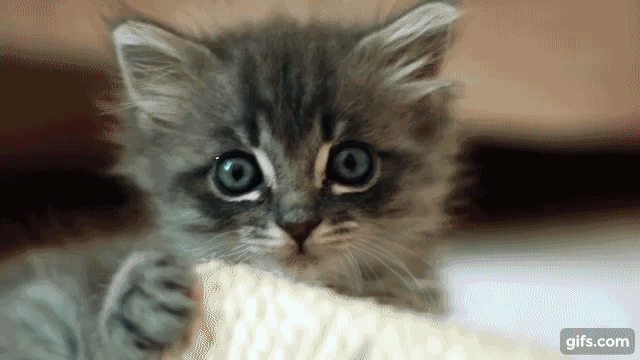

In [24]:
from IPython.display import Image
with open('F:/zom_pic.gif','rb') as img:
    display(Image(data = img.read(), format = 'png'))

Every photograph, in digital form, is made up of pixels. They are the smallest unit of information that makes up a picture. Usually round or square, they are typically arranged in a 2-dimensional grid. 

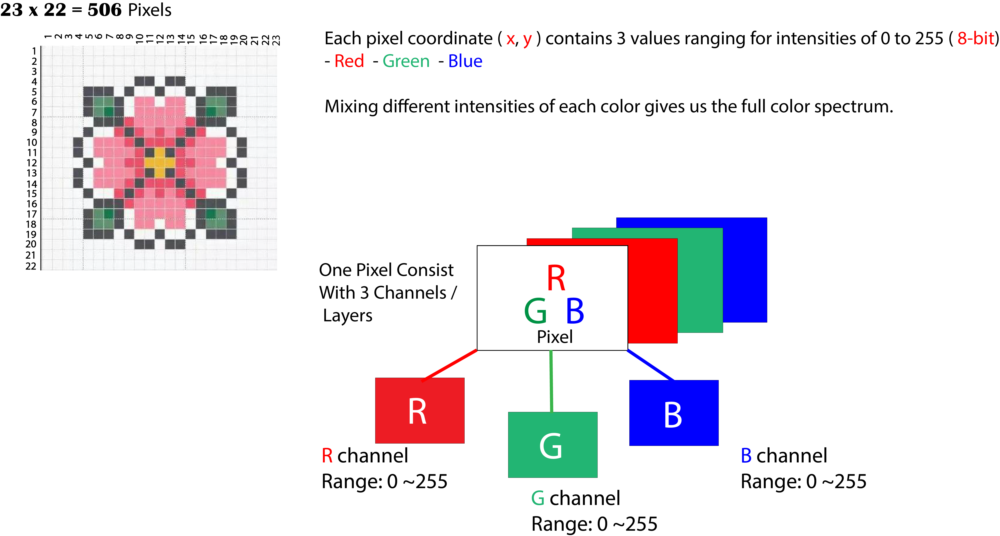

In [25]:
Image("F:/rgb_explain.png")

Now, if all three values are at full intensity, that means they're 255, it then shows as white and if all three colors are muted, or has the value of 0, the color shows as black. The combination of these three will, in turn, give us a specific shade of the pixel color. Since each number is an **8-bit** number, the values range from **`0-255`**. 

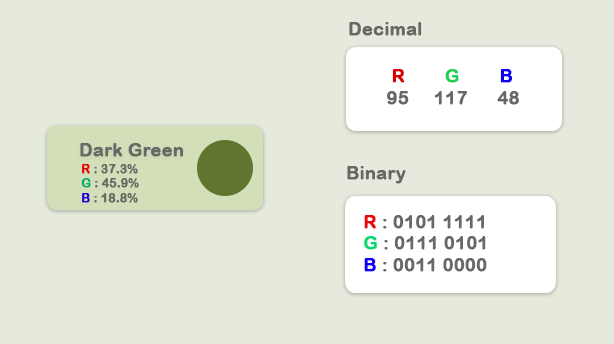

In [26]:
Image("F:/dec_to_bin.png")

Combination of these three color will posses tends to the hightest value among them. Since each value can have 256 different intesity or brightness value, it makes **16.8** million total shades.

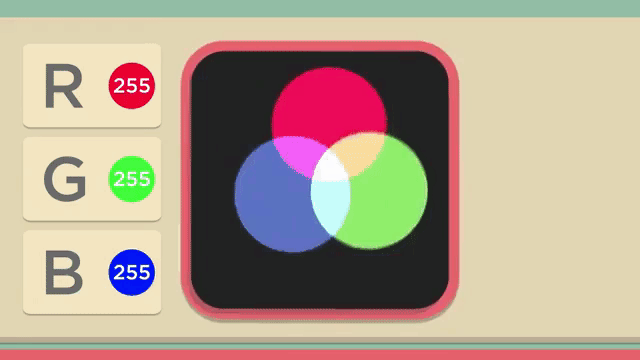

In [27]:
with open('F:/rig_gif.gif','rb') as f:
    display(Image(data=f.read(), format='gif'))

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Importing Image</p>

Now let's load an image and observe its various properties in general.

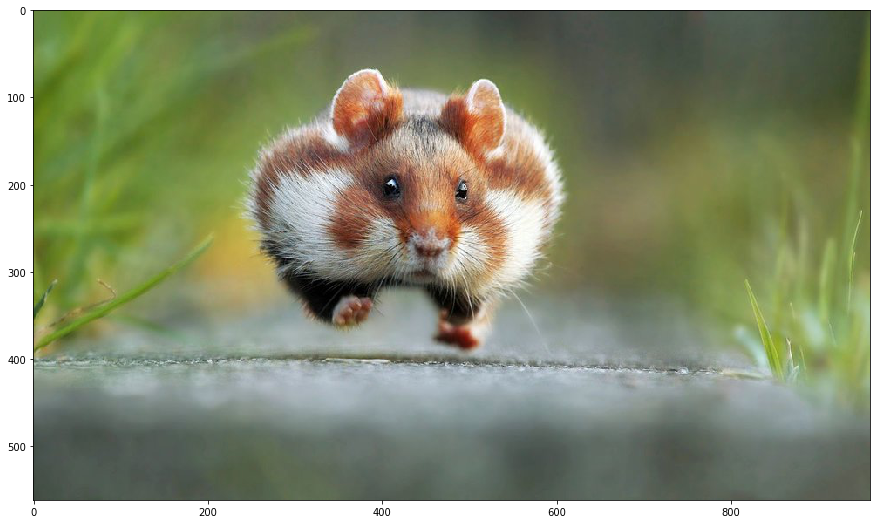

In [28]:
if __name__ == '__main__':
    import imageio
    import matplotlib.pyplot as plt
    %matplotlib inline

    pic = imageio.imread('F:/demo_2.jpg')
    plt.figure(figsize = (15,15))

    plt.imshow(pic)

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Observe Basic Properties of Image</p>


In [29]:
print('Type of the image : ' , type(pic))
print()
print('Shape of the image : {}'.format(pic.shape))
print('Image Hight {}'.format(pic.shape[0]))
print('Image Width {}'.format(pic.shape[1]))
print('Dimension of Image {}'.format(pic.ndim))

Type of the image :  <class 'imageio.core.util.Image'>

Shape of the image : (562, 960, 3)
Image Hight 562
Image Width 960
Dimension of Image 3


The shape of the ndarray show that it is a three layered matrix. The first two numbers here are length and width, and the third number (i.e. 3) is for three layers: **`Red, Green, Blue`**. So, if we calculate the size of a RGB image, the total size will be counted as **`height x width x 3`**

In [30]:
print('Image size {}'.format(pic.size))

Image size 1618560


In [31]:
print('Maximum RGB value in this image {}'.format(pic.max()))
print('Minimum RGB value in this image {}'.format(pic.min()))

Maximum RGB value in this image 255
Minimum RGB value in this image 0


These values are important to verify since the eight bit color intensity is, can not be outside of the 0 to 255 range. 

Now, using the picture assigned variable we can also access any particular pixel value of an image and further can access each **RGB** channel separetly.

In [32]:
'''
Let's pick a specific pixel located at 100 th Rows and 50 th Column. 
And view the RGB value gradually. 
'''
pic[ 100, 50 ]

Image([109, 143,  46], dtype=uint8)

In these case: R = 109 ; G = 143 ; B = 46 and we can realize that this particular pixel has a lot of GREEN in it. And now we could have also selected one of this number specifically by giving the index value of these three channel. Now we know for this

- `0` index value for **Red** channel
- `1` index value for **Green** channel
- `2` index value for **Blue** channel

But good to know that in OpenCV, Images takes as not RGB but BGR. `imageio.imread` loads image as RGB (or RGBA), but OpenCV assumes the image to be [BGR or BGRA](https://docs.opencv.org/trunk/d4/da8/group__imgcodecs.html#gabbc7ef1aa2edfaa87772f1202d67e0ce) (BGR is the default OpenCV colour format).

In [34]:
# A specific pixel located at Row : 100 ; Column : 50 
# Each channel's value of it, gradually R , G , B
print('Value of only R channel {}'.format(pic[ 100, 50, 0]))
print('Value of only G channel {}'.format(pic[ 100, 50, 1]))
print('Value of only B channel {}'.format(pic[ 100, 50, 2]))

Value of only R channel 109
Value of only G channel 143
Value of only B channel 46


OK, now let's take a quick view of each channels in the whole image. 

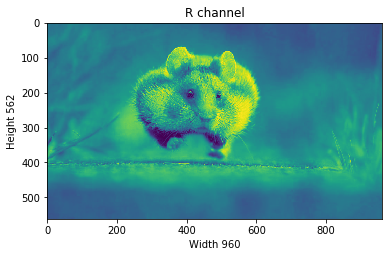

In [35]:
plt.title('R channel')
plt.ylabel('Height {}'.format(pic.shape[0]))
plt.xlabel('Width {}'.format(pic.shape[1]))

plt.imshow(pic[ : , : , 0])
plt.show()

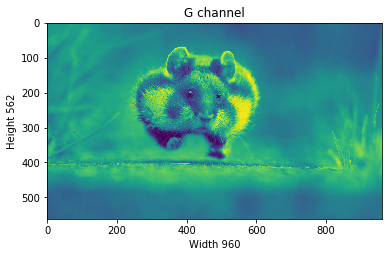

In [36]:
plt.title('G channel')
plt.ylabel('Height {}'.format(pic.shape[0]))
plt.xlabel('Width {}'.format(pic.shape[1]))

plt.imshow(pic[ : , : , 1])
plt.show()

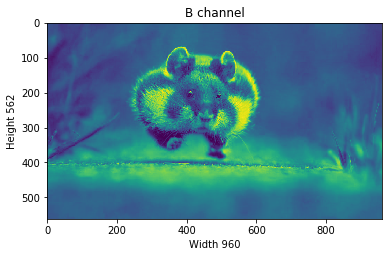

In [37]:
plt.title('B channel')
plt.ylabel('Height {}'.format(pic.shape[0]))
plt.xlabel('Width {}'.format(pic.shape[1]))

plt.imshow(pic[ : , : , 2])
plt.show()

Now, here we can also able to change the number of RGB values. As an example, let's set the Red, Green, Blue layer for following Rows values to full intensity.

- R channel: Row-  50 to 150
- G channel: Row- 200 to 300
- B channel: Row- 350 to 450

We'll load the image once, so that we can visualize each change simultaneously.

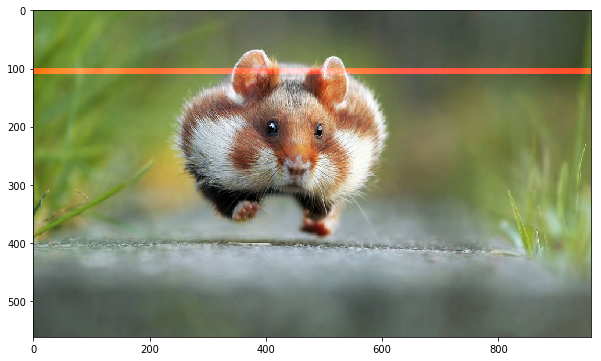

In [38]:
pic = imageio.imread('F:/demo_2.jpg')

pic[100:110 , : , 0] = 255 # full intensity to those pixel's R channel
plt.figure( figsize = (10,10))
plt.imshow(pic)
plt.show()

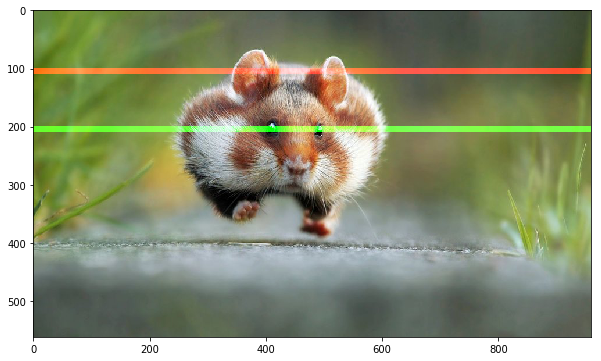

In [39]:
pic[200:210 , : , 1] = 255 # full intensity to those pixel's G channel
plt.figure( figsize = (10,10))
plt.imshow(pic)
plt.show()

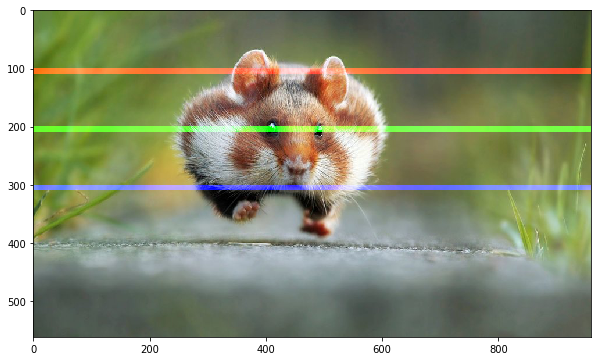

In [40]:
pic[300:310 , : , 2] = 255 # full intensity to those pixel's B channel
plt.figure( figsize = (10,10))
plt.imshow(pic)
plt.show()

To make it more clear let's change the column section and this time we'll change the RGB channel simultaneously.

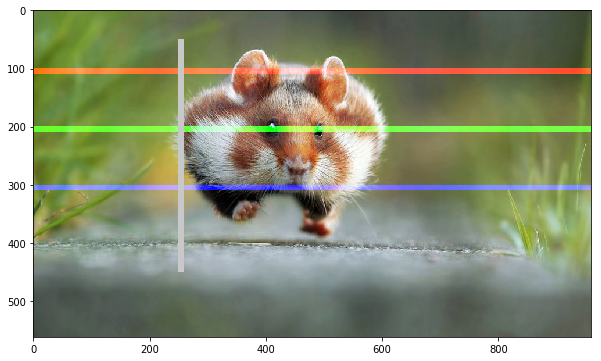

In [41]:
# set value 200 of all channels to those pixels which turns them to white
pic[ 50:450 , 250:260 , [0,1,2] ] = 200 
plt.figure( figsize = (10,10))
plt.imshow(pic)
plt.show()

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Splitting Layers</p>

Now, we know that each pixel of the image is represented by three integers. Splitting the image into seperate colour components is just a matter of pulling out the correct slice of the image array.

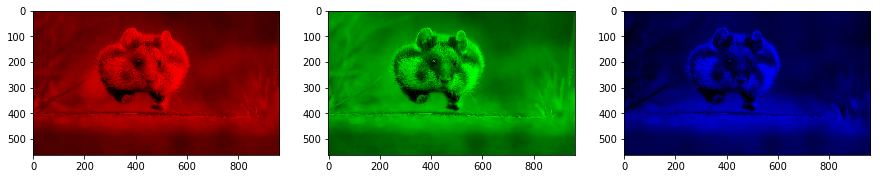

In [42]:
import numpy as np
pic = imageio.imread('F:/demo_2.jpg')

fig, ax = plt.subplots(nrows = 1, ncols=3, figsize=(15,5))

for c, ax in zip(range(3), ax):
    
    # create zero matrix
    split_img = np.zeros(pic.shape, dtype="uint8") # 'dtype' by default: 'numpy.float64'
    
    # assing each channel 
    split_img[ :, :, c] = pic[ :, :, c]
    
    # display each channel
    ax.imshow(split_img)

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Greyscale</p>

Black and white images are stored in 2-Dimentional arrays. There're two types of Black and White images:

- **Greyscale** : Ranges of shades of grey : `0` ~ `255`
- **Binary** : Pixel are either black or white : `0` or `255`

Now, Greyscaling is such process by which an image is converted from a full color to shades of grey. In image processing tools, for example: in OpenCV, many function uses greyscale images before porcessing and this is done because it simplifies the image, acting almost as a noise reduction and increasing processing time as there's less information in the images.

There are a couple of ways to do this in python to [convert image to grayscale](https://stackoverflow.com/a/45338831/9215780). But a straight forward way using matplotlib is to take the weighted mean of the RGB value of original image using [this](http://en.wikipedia.org/wiki/Grayscale#Converting_color_to_grayscale) formula.

`Y' = 0.299 R + 0.587 G + 0.114 B `

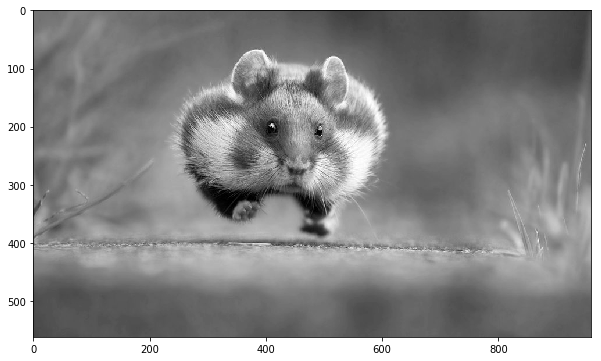

In [43]:
pic = imageio.imread('F:/demo_2.jpg')

gray = lambda rgb : np.dot(rgb[... , :3] , [0.299 , 0.587, 0.114]) 
gray = gray(pic)  

plt.figure( figsize = (10,10))
plt.imshow(gray, cmap = plt.get_cmap(name = 'gray'))
plt.show()

---

However, the [GIMP](https://docs.gimp.org/2.6/en/gimp-tool-desaturate.html) converting color to grayscale image software has three algorithms to do the task.

**Lightness**
The graylevel will be calculated as

`Lightness = ½ × (max(R,G,B) + min(R,G,B))`

**Luminosity**
The graylevel will be calculated as

`Luminosity = 0.21 × R + 0.72 × G + 0.07 × B`

**Average**
The graylevel will be calculated as

`Average Brightness = (R + G + B) ÷ 3`

Let's give a try one of their algorithm, what about Luminosity.

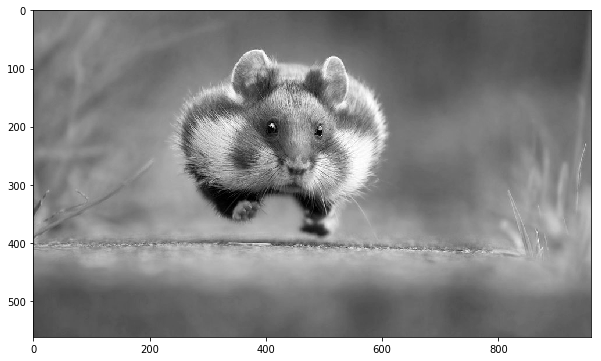

Type of the image :  <class 'imageio.core.util.Image'>

Shape of the image : (562, 960)
Image Hight 562
Image Width 960
Dimension of Image 2

Image size 539520
Maximum RGB value in this image 254.99999999999997
Minimum RGB value in this image 0.0
Random indexes [X,Y] : 129.07


In [44]:
pic = imageio.imread('F:/demo_2.jpg')

gray = lambda rgb : np.dot(rgb[... , :3] , [0.21 , 0.72, 0.07]) 
gray = gray(pic)  

plt.figure( figsize = (10,10))
plt.imshow(gray, cmap = plt.get_cmap(name = 'gray'))
plt.show()

'''
Let's take a quick overview some the changed properties now the color image.
Like we observe some properties of color image, same statements are applying 
now for gray scaled image.
'''

print('Type of the image : ' , type(gray))
print()
print('Shape of the image : {}'.format(gray.shape))
print('Image Hight {}'.format(gray.shape[0]))
print('Image Width {}'.format(gray.shape[1]))
print('Dimension of Image {}'.format(gray.ndim))
print()
print('Image size {}'.format(gray.size))
print('Maximum RGB value in this image {}'.format(gray.max()))
print('Minimum RGB value in this image {}'.format(gray.min()))
print('Random indexes [X,Y] : {}'.format(gray[100, 50]))

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Use logical Operator To Process Pixel Values</p>



We can create a bullion ndarray in the same size by using a **logical operator**. However, this won't create any new array but it simply return `True` to its host variable. For example: let's consider we want to filter out some low value pixel or high value or (within any condition) in an RGB image and yes it would be great to convert RGB to gray scale but for now we won't go for that rather than deal with color image.

Let's first load an image and show it on screen.

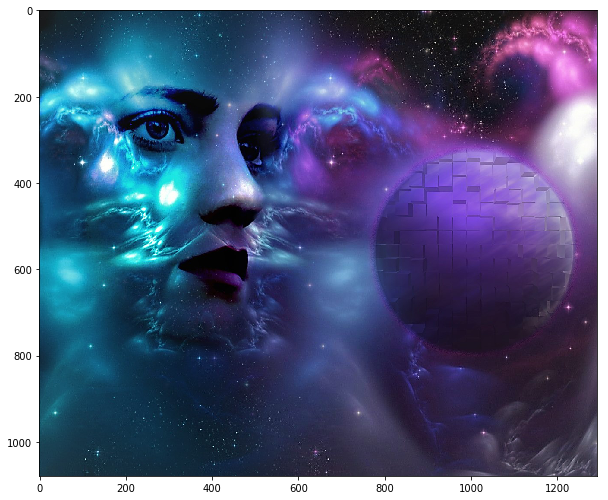

In [45]:
pic = imageio.imread('F:/demo_1.jpg')
plt.figure(figsize = (10,10))
plt.imshow(pic)
plt.show()

OK, let's consider this dump image. Now, for any case we want to filter out all the pixel value which is below than, let's assume 20. For this we'll use logical operator to do this task which we'll return as a value of `True` for all the index.

In [46]:
low_pixel = pic < 20

# to ensure of it let's check if all values in low_pixel are True or not
if low_pixel.any() == True:
    print(low_pixel.shape)

(1079, 1293, 3)


Now as we said, a host variable , well this name is not traditionally use but i refer it because it behaves. It just hold the True or False value and nothing else. So, if we see the `shape` of both `low_pixel` and `pic` , we'll find that both have the same `shape`.

In [47]:
print(pic.shape)
print(low_pixel.shape)

(1079, 1293, 3)
(1079, 1293, 3)


We generated that low value filter using a global comparison operator for all the values less than 200. However, we can use this `low_pixel` array as an index to set those low values to some specific values which may be higher than or lower than the previous pixel value.

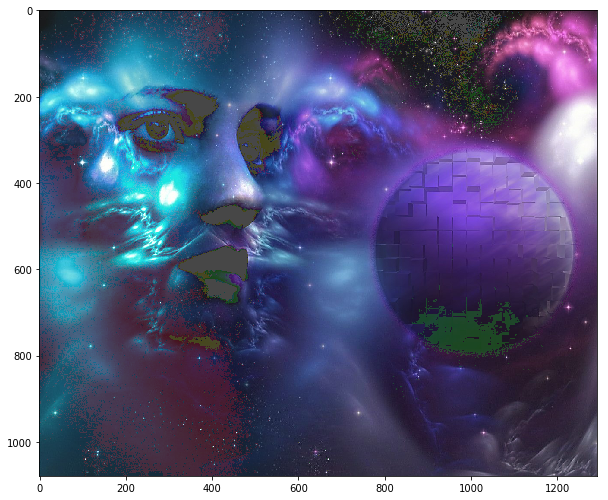

In [48]:
# randomly choose a value 
import random

# load the orginal image
pic = imageio.imread('F:/demo_1.jpg')

# set value randomly range from 25 to 225 - these value also randomly choosen
pic[low_pixel] = random.randint(25,225)

# display the image
plt.figure( figsize = (10,10))
plt.imshow(pic)
plt.show()

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Masking</p>

Image masking is an image processing technique that is used to remove the background from which photographs those have blurred/fuzzy edges, transparent or hair portions. 

Now, we'll create a mask that is in shape of a circular disc. First we'll measure distance from center of the image to every border pixel values. And we take a convenient radius value and then usng logical operator we'll create a circular disc. It's quite simple, let's see the code.


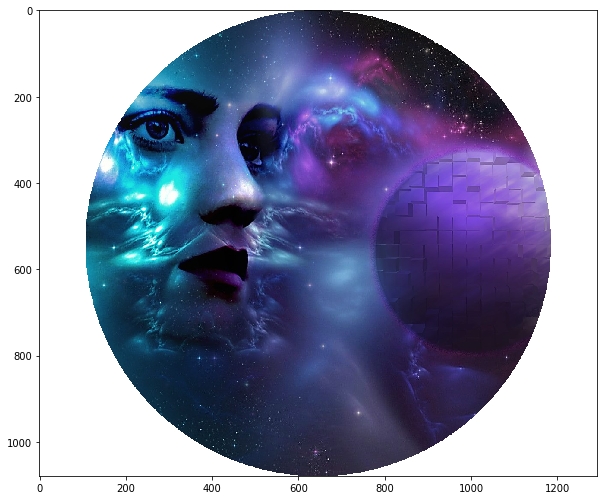

In [49]:
if __name__ == '__main__':
    
    # load the image
    pic = imageio.imread('F:/demo_1.jpg')
    
    # seperate the row and column values
    total_row , total_col , layers = pic.shape
    
    '''
    Create vector.
    
    Ogrid is a compact method of creating a multidimensional-
    ndarray operations in single lines.
    for ex:
    
    >>> ogrid[0:5,0:5]
    output: [array([[0],
                    [1],
                    [2],
                    [3],
                    [4]]), 
            array([[0, 1, 2, 3, 4]])]
            
    '''
    x , y = np.ogrid[:total_row , :total_col]

    # get the center values of the image
    cen_x , cen_y = total_row/2 , total_col/2
    
    
    '''
    Measure distance value from center to each border pixel.
    To make it easy, we can think it's like, we draw a line from center-
    to each edge pixel value --> s**2 = (Y-y)**2 + (X-x)**2 
    '''
    distance_from_the_center = np.sqrt((x-cen_x)**2 + (y-cen_y)**2)

    # Select convenient radius value
    radius = (total_row/2)

    # Using logical operator '>' 
    '''
    logical operator to do this task which will return as a value 
    of True for all the index according to the given condition
    '''
    circular_pic = distance_from_the_center > radius

    '''
    let assign value zero for all pixel value that outside the cirular disc.
    All the pixel value outside the circular disc, will be black now.
    '''
    pic[circular_pic] = 255
    plt.figure(figsize = (10,10))
    plt.imshow(pic) 
    plt.show()

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Satellite Image Processing</p>

One of my MOOC course on edX i've introduced with some the satellite images and it's processing system. It's very informative. Let's do a quick view of it.

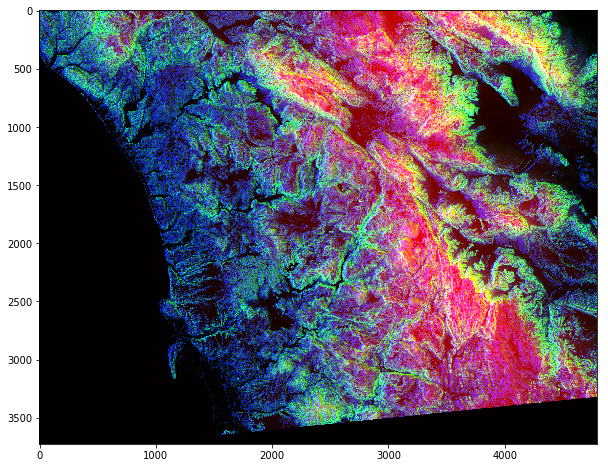

In [50]:
# load the image
pic = imageio.imread('F:\satimg.jpg')
plt.figure(figsize = (10,10))
plt.imshow(pic)
plt.show()

In [51]:
print(f'Shape of the image {pic.shape}')
print(f'hieght {pic.shape[0]} pixels')
print(f'width {pic.shape[1]} pixels')

Shape of the image (3725, 4797, 3)
hieght 3725 pixels
width 4797 pixels


Now, There's something interesting about this image. Like many other visualizations, the colors in each rgb layer mean something. For example, the intensity of the red will be an indication of altitude of the geographical data point in the pixel. The intensity of blue will indicate a measure of aspect and the green will indicate slope. These colors will help to communicate this information in a quicker and more effective way rather than showing numbers.

<ul>
    
<li><p style="font-family: Arial; font-size:1.15em;color:red; font-style:bold">
Red pixel indicates: Altitude</p>
<li><p style="font-family: Arial; font-size:1.15em;color:blue; font-style:bold">
Blue pixel indicates: Aspect</p>
<li><p style="font-family: Arial; font-size:1.15em;color:green; font-style:bold">Green pixel indicates: Slope</p>

</ul>

There is, by just looking at this colorful image, a trained eye can tell already what the altitude, what's the slope, what's the aspect. So that's the idea of loading some more meaning to these colors to indicate something more scientific.

<p style="font-family: Arial; font-size:1.35em;color:#2462C0; font-style:bold"><br>Detecting High Pixel of Each Channel</p>

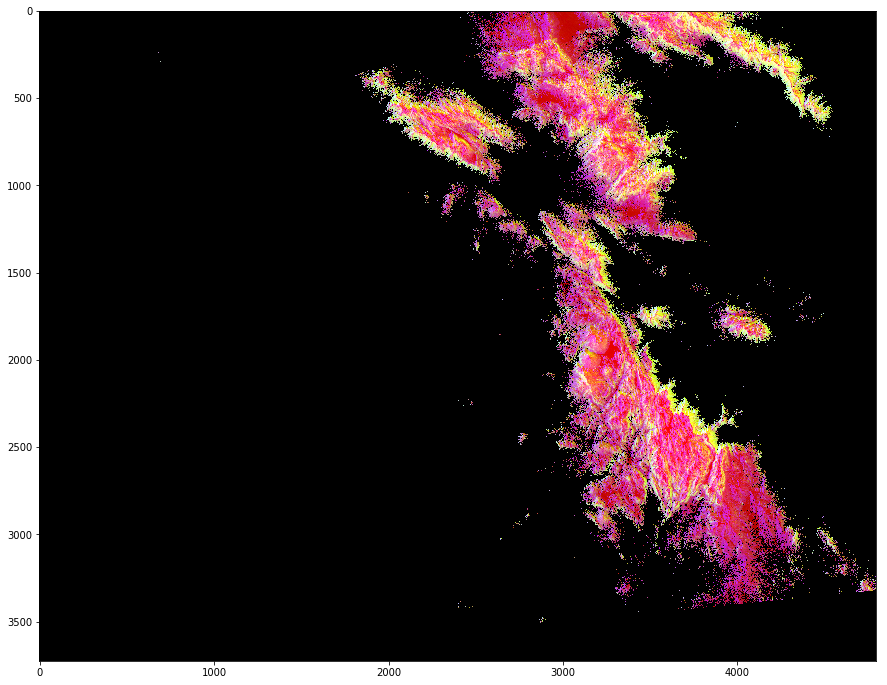

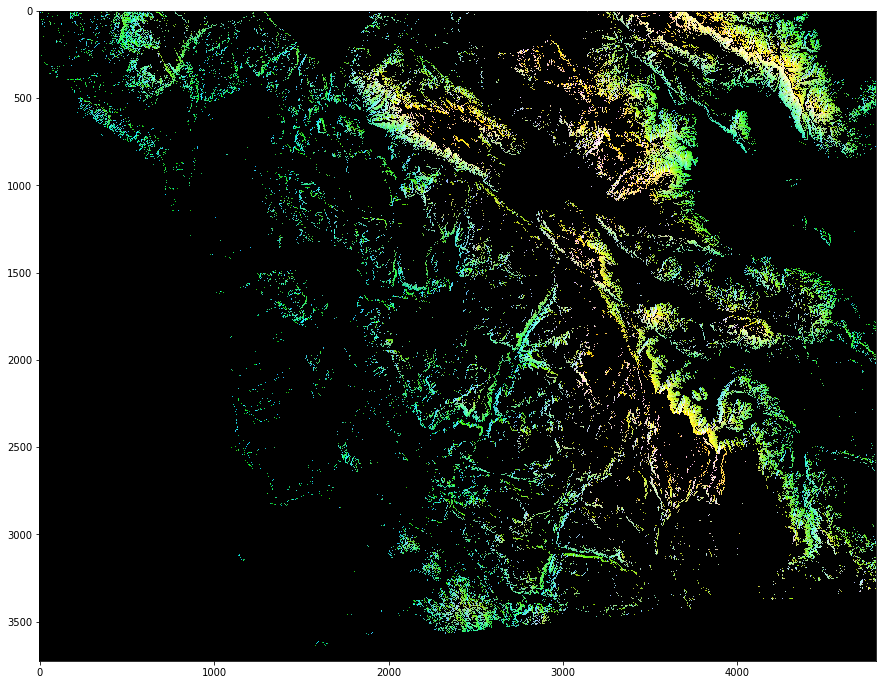

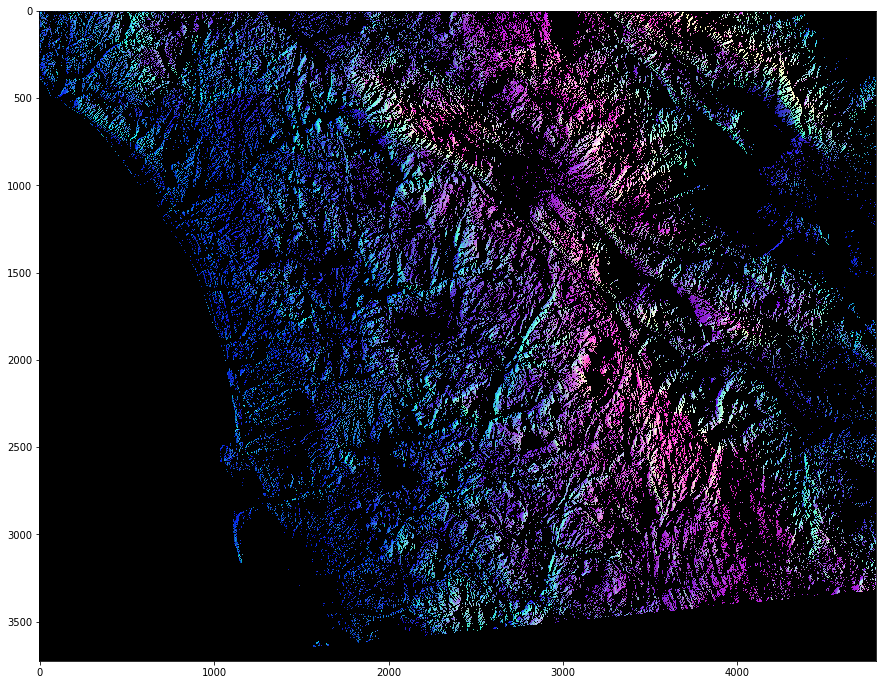

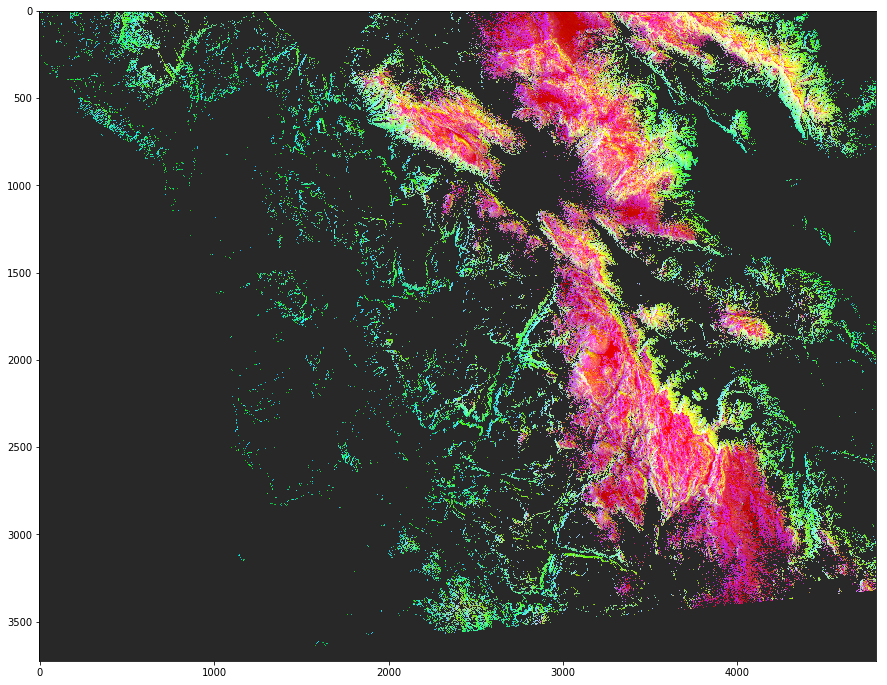

In [52]:
# Only Red Pixel value , higher than 180
pic = imageio.imread('F:\satimg.jpg')
red_mask = pic[:, :, 0] < 180

pic[red_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(pic)


# Only Green Pixel value , higher than 180
pic = imageio.imread('F:\satimg.jpg')
green_mask = pic[:, :, 1] < 180

pic[green_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(pic)


# Only Blue Pixel value , higher than 180
pic = imageio.imread('F:\satimg.jpg')
blue_mask = pic[:, :, 2] < 180

pic[blue_mask] = 0
plt.figure(figsize=(15,15))
plt.imshow(pic)

# Composite mask using logical_and
pic = imageio.imread('F:\satimg.jpg')
final_mask = np.logical_and(red_mask, green_mask, blue_mask)
pic[final_mask] = 40
plt.figure(figsize=(15,15))
plt.imshow(pic)

continue..